This code based on the repository https://github.com/HACKERSHUBH/Face-Genaration-using-Generative-Adversarial-Network

In [9]:
data_dir = '../celebA/'
import helper

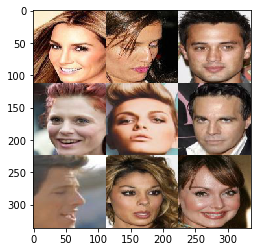

In [10]:
%matplotlib inline
import os
from glob import glob
import numpy as np
from matplotlib import pyplot
show_n_images = 9

mnist_images = helper.get_batch(glob(os.path.join(data_dir, '*.jpg'))[:show_n_images], 112, 112, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

In [11]:
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.13.1
Default GPU Device: /device:GPU:0


In [12]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    real_input_images = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], 'real_input_images')
    input_z = tf.placeholder(tf.float32, [None, z_dim], 'input_z')
    learning_rate_g = tf.placeholder(tf.float32, [], 'learning_rate_g')
    learning_rate_d = tf.placeholder(tf.float32, [], 'learning_rate_d')
    return real_input_images, input_z, learning_rate_g, learning_rate_d

tests.test_model_inputs(model_inputs)

Tests Passed


In [13]:
def discriminator(images, reuse=False, alpha=0.2, keep_prob=0.4):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 112x112xn
        # Convolutional layer, 56x56x64
        conv1 = tf.layers.conv2d(images, 64, 5, 2, padding='same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        lrelu1 = tf.maximum(alpha * conv1, conv1)
        drop1 = tf.layers.dropout(lrelu1, keep_prob)
       
        # Strided convolutional layer, 28x28x128
        conv2 = tf.layers.conv2d(drop1, 128, 5, 2, 'same', use_bias=False)
        bn2 = tf.layers.batch_normalization(conv2)
        lrelu2 = tf.maximum(alpha * bn2, bn2)
        drop2 = tf.layers.dropout(lrelu2, keep_prob)
        
        # Strided convolutional layer, 14x14x256
        conv3 = tf.layers.conv2d(drop2, 256, 5, 2, 'same', use_bias=False)
        bn3 = tf.layers.batch_normalization(conv3)
        lrelu3 = tf.maximum(alpha * bn3, bn3)
        drop3 = tf.layers.dropout(lrelu3, keep_prob)

        # Strided convolutional layer, 14x14x512
        conv4 = tf.layers.conv2d(drop3, 512, 5, 1, 'same', use_bias=False)
        bn4 = tf.layers.batch_normalization(conv4)
        lrelu4 = tf.maximum(alpha * bn4, bn4)
        drop4 = tf.layers.dropout(lrelu4, keep_prob)

        # Strided convolutional layer, 7x7x1024
        conv5 = tf.layers.conv2d(drop4, 1024, 5, 2, 'same', use_bias=False)
        bn5 = tf.layers.batch_normalization(conv5)
        lrelu5 = tf.maximum(alpha * bn5, bn5)
        drop5 = tf.layers.dropout(lrelu5, keep_prob)

        # fully connected
        flat = tf.reshape(drop5, (-1, 7*7*1024))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

tests.test_discriminator(discriminator, tf)

Tests Passed


In [14]:
import problem_unittests as tests

def generator(z, out_channel_dim, is_train=True, alpha=0.2, keep_prob=0.4):
    with tf.variable_scope('generator', reuse=(not is_train)):
        # First fully connected layer, 7x7x1024
        fc = tf.layers.dense(z, 7*7*1024, use_bias=False)
        fc = tf.reshape(fc, (-1, 7, 7, 1024))
        bn0 = tf.layers.batch_normalization(fc, training=is_train)
        lrelu0 = tf.maximum(alpha * bn0, bn0)
        drop0 = tf.layers.dropout(lrelu0, keep_prob, training=is_train)

        # Deconvolution, 14x14x512
        conv1 = tf.layers.conv2d_transpose(drop0, 512, 5, 2, 'same', use_bias=False)
        bn1 = tf.layers.batch_normalization(conv1, training=is_train)
        lrelu1 = tf.maximum(alpha * bn1, bn1)
        drop1 = tf.layers.dropout(lrelu1, keep_prob, training=is_train)
        
        # Deconvolution, 28x28x256
        conv2 = tf.layers.conv2d_transpose(drop1, 256, 5, 2, 'same', use_bias=False)
        bn2 = tf.layers.batch_normalization(conv2, training=is_train)
        lrelu2 = tf.maximum(alpha * bn2, bn2)
        drop2 = tf.layers.dropout(lrelu2, keep_prob, training=is_train)
        
        # Deconvolution, 56x56x128
        conv3 = tf.layers.conv2d_transpose(drop2, 128, 5, 2, 'same', use_bias=False)
        bn3 = tf.layers.batch_normalization(conv3, training=is_train)
        lrelu3 = tf.maximum(alpha * bn3, bn3)
        drop3 = tf.layers.dropout(lrelu3, keep_prob, training=is_train)
        
        # Output layer, 112x112xn
        logits = tf.layers.conv2d_transpose(drop3, out_channel_dim, 5, 2, 'same')
        
        out = tf.tanh(logits)        
        return out
tests.test_generator(generator, tf)

Tests Passed


In [15]:
def model_loss(input_real, input_z, out_channel_dim, alpha=0.2, smooth_factor=0.1):
    input_fake = generator(input_z, out_channel_dim, alpha=alpha)

    noisy_input_real = input_real + tf.random_normal(shape=tf.shape(input_real),
                                                     mean=0.0,
                                                     stddev=np.random.uniform(0.0, 0.1),
                                                     dtype=tf.float32)
    
    d_model_real, d_logits_real = discriminator(noisy_input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(input_fake, reuse=True, alpha=alpha)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                labels=tf.ones_like(d_model_real) * np.random.uniform(0.9, 0.1)))
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))

    d_loss = tf.reduce_mean(0.5 * (d_loss_real + d_loss_fake))
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    return d_loss, g_loss
tests.test_model_loss(model_loss)

Tests Passed


In [16]:
def model_opt(d_loss, g_loss, LR_D, LR_G, beta1):
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    gen_updates = [op for op in update_ops if op.name.startswith('generator') or op.name.startswith('discriminator')]
    
    # Optimize
    with tf.control_dependencies(gen_updates):
        d_train_opt = tf.train.AdamOptimizer(LR_D, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(LR_G, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt
tests.test_model_opt(model_opt, tf)

Tests Passed


In [17]:
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(generator(input_z, out_channel_dim, False), feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    return images_grid

In [18]:
def train(epoch_count, batch_size, z_dim, LR_D, LR_G, beta1, get_batches, data_shape, data_image_mode,
          print_every=10, show_every=50):
    input_real, input_z, lr_G, lr_D = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3], alpha=0.2)
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, LR_D, LR_G, beta1)
       
    steps = 0
    count = 0
    fig, axs = pyplot.subplots(1, 1)
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        saver = tf.train.Saver()
        if tf.train.latest_checkpoint('./model/') is not None:
            saver.restore(sess, tf.train.latest_checkpoint('./model/'))
        if not os.path.exists('output'):
            os.mkdir('output')
        for epoch_i in range(epoch_count):
            os.mkdir('output/'+ str(epoch_i))
            for batch_images in get_batches(batch_size):
                steps += 1
                batch_images *= 2.0
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))                
                
                # Run optimizers
                sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr_D: LR_D})
                sess.run(g_train_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr_G: LR_G})
                
                if steps % print_every == 0:
                    train_loss_d = d_loss.eval({input_real: batch_images, input_z: batch_z})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    print("Epoch {}/{} Step {}...".format(epoch_i+1, epoch_count, steps),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g))
                     
                if steps % show_every == 0:
                    count = count + 1
                    iterr = count * show_every
                    images_grid = show_generator_output(sess, 9, input_z, data_shape[3], data_image_mode)
                    dst = os.path.join("output", str(epoch_i), str(iterr) + ".png")
                    pyplot.imshow(images_grid)
                    fig.savefig("output/" + str(epoch_i) + "/" + str(iterr) + ".png")                    
                     # saving the model         
                    if epoch_i % 5 == 0:
                        if not os.path.exists('./model/'):
                            os.makedirs('./model')
                        saver.save(sess, './model/' + str(epoch_i))      

In [19]:
tf.reset_default_graph()
batch_size = 64
z_dim = 100
LR_D = 0.00004
LR_G = 0.0002
beta1 = 0.5
# Uncomment if you want to train the model
'''
epochs = 20

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, '*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, LR_D, LR_G, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)
'''

"\nepochs = 20\n\nceleba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, '*.jpg')))\nwith tf.Graph().as_default():\n    train(epochs, batch_size, z_dim, LR_D, LR_G, beta1, celeba_dataset.get_batches,\n          celeba_dataset.shape, celeba_dataset.image_mode)\n"

INFO:tensorflow:Restoring parameters from ./model/20


C:\Users\user\Anaconda3\envs\tfpose\lib\site-packages\ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


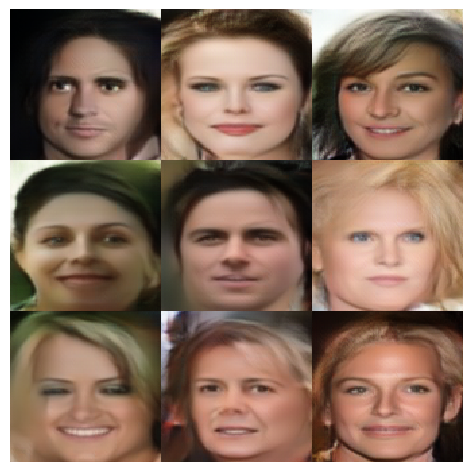

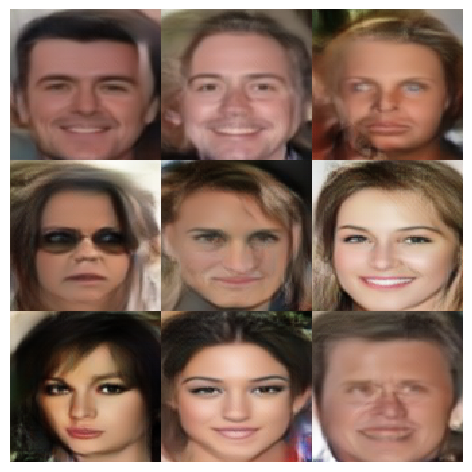

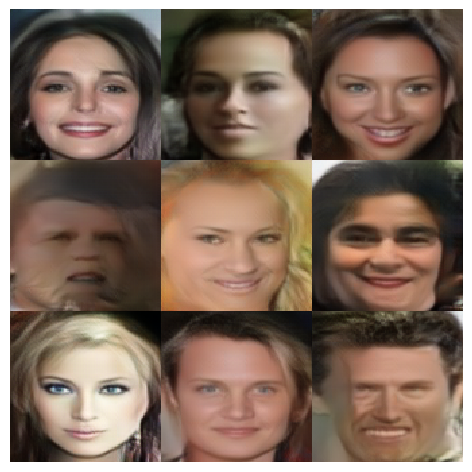

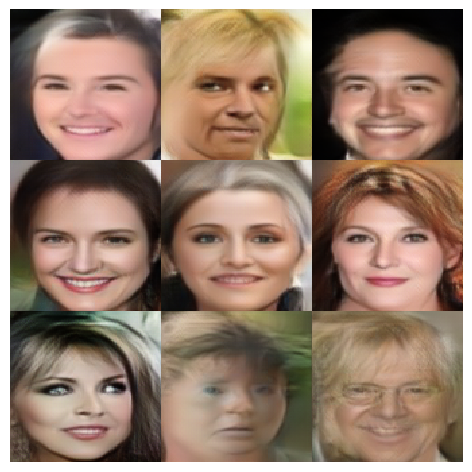

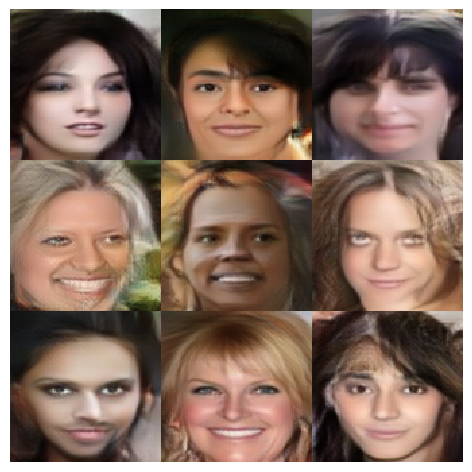

...

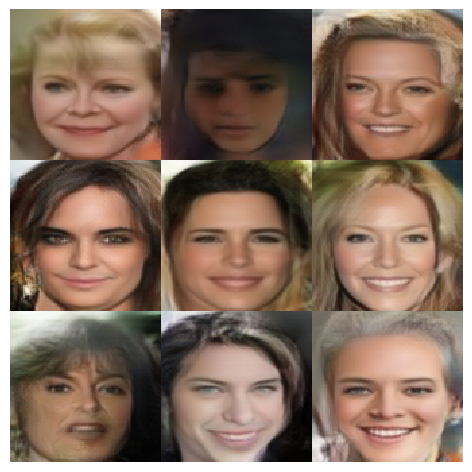

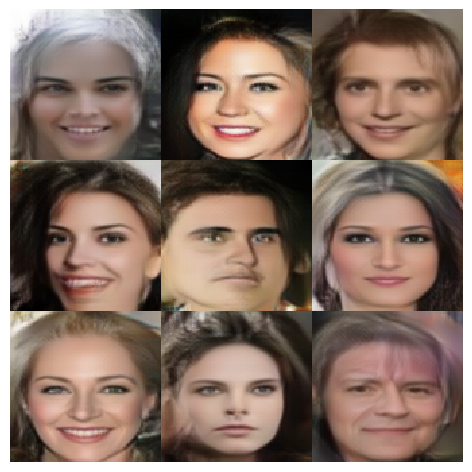

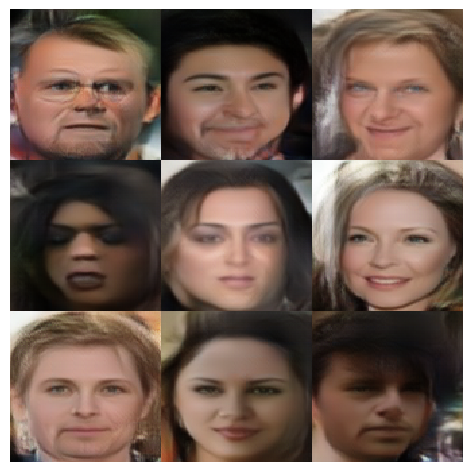

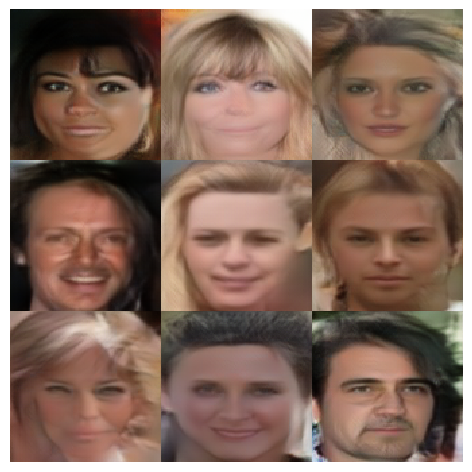

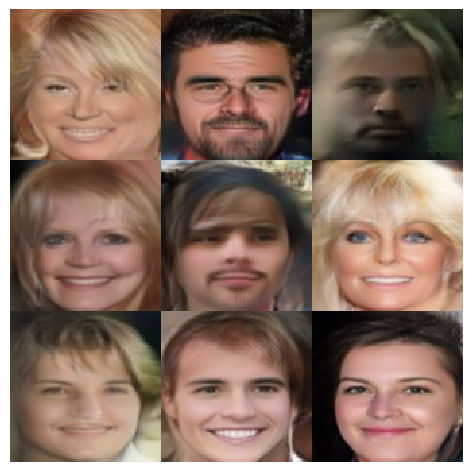

In [ ]:
# run from checkpoint
tf.reset_default_graph()
celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, '*.jpg')))
data_shape = celeba_dataset.shape
get_batches = celeba_dataset.get_batches

input_real, input_z, lr_G, lr_D = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
d_loss, g_loss = model_loss(input_real, input_z, data_shape[3], alpha=0.2)
d_train_opt, g_train_opt = model_opt(d_loss, g_loss, LR_D, LR_G, beta1)

data_image_mode = celeba_dataset.image_mode
saver = tf.train.Saver()

with tf.Session() as sess:
    saver = tf.train.Saver()
    sess.run(tf.global_variables_initializer())
    if tf.train.latest_checkpoint('./model/') is not None:
        saver.restore(sess, tf.train.latest_checkpoint('./model/'))
    else:
        save_path = saver.save(sess, "/tmp/model.ckpt")
        saver.restore(sess, save_path)
    if not os.path.exists('output_baseline'):
        os.mkdir('output_baseline')
    for batch_images in get_batches(batch_size):
        batch_images *= 2.0
        break

    batch_z = np.random.normal(-1, 1, size=(batch_size, z_dim))

    # Run optimizers
    sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z})
    sess.run(g_train_opt, feed_dict={input_z: batch_z})
    
    for i in range(500):
        images_grid = show_generator_output(sess, 9, input_z, data_shape[3], data_image_mode)
        pyplot.figure(figsize=(6, 6), dpi=100)
        pyplot.imshow(images_grid)
        pyplot.axis("off")
        pyplot.savefig("output_baseline/" + format(i + 1, '03d') + "_image.png")